# Импорт библиотек

In [1]:
import os

import matplotlib.animation as animation
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import torchvision.utils as vutils
from IPython.display import HTML

In [19]:
# Number of workers for dataloader
workers = 2
batch_size = 512
image_size = 64
in_channels = 3
z_dim = 100
generator_dim = 64
discriminator_dim = 64

# Number of training epochs
num_epochs = 5

# Learning rate for optimizers
lr = 2e-4
lr_g = lr
lr_d = lr * 0.05

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [3]:
device = torch.device("cuda:1" if torch.cuda.is_available() else "cpu")

# Загрузка данных

In [4]:
import torch

transform=transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

dataset_root = os.path.join(os.pardir, "celeba")
# Скачивание и загрузка датасета CelebA
dataset = datasets.ImageFolder(root=dataset_root, transform=transform)

# Создание DataLoader для итерации по датасету
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

Выведем примеры картинок из трейна

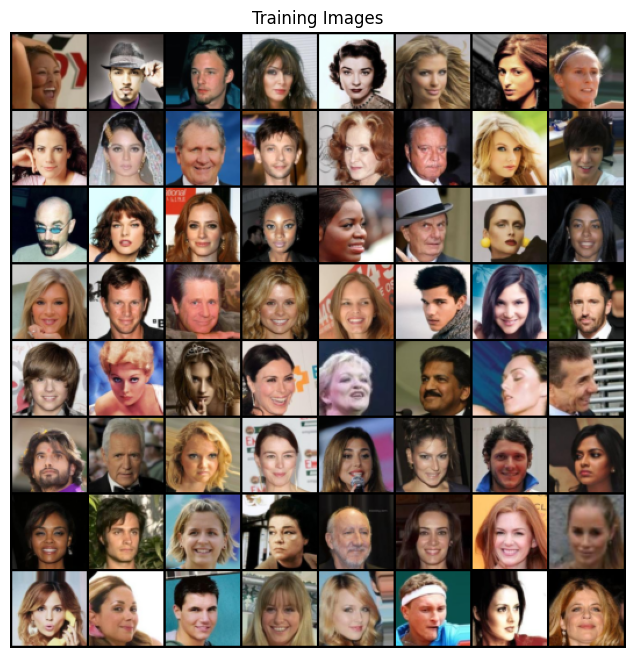

In [5]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [6]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [7]:
class CSPup(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        
        self.split_channels = in_channels // 2
        
        self.conv_path = nn.Sequential(
            nn.Conv2d(self.split_channels, self.split_channels, kernel_size=1, bias=False),
            nn.BatchNorm2d(self.split_channels),
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(self.split_channels, self.split_channels, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(self.split_channels),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(self.split_channels, self.split_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(self.split_channels),
            nn.ReLU(inplace=True),

            nn.Conv2d(self.split_channels, self.split_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(self.split_channels),
            nn.ReLU(inplace=True)
        )

        self.upsample_path = nn.Sequential(
            nn.ConvTranspose2d(self.split_channels, self.split_channels, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(self.split_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        x1, x2 = x.chunk(2, dim=1)
        
        conv_out = self.conv_path(x1)
        upsample_out = self.upsample_path(x2)
        
        out = conv_out + upsample_out
        return out

In [9]:
class Generator(nn.Module):
    def __init__(self, z_dim=100, img_channels=3):
        super().__init__()

        self.initial = nn.Sequential(
            nn.ConvTranspose2d(z_dim, 1024, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(1024),
            nn.ReLU(True)
        )

        self.up1 = CSPup(1024, 512)
        self.up2 = CSPup(512, 256)
        self.up3 = CSPup(256, 128)

        self.final = nn.Sequential(
            nn.ConvTranspose2d(128, img_channels, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )

    def forward(self, z):
        x = self.initial(z)
        x = self.up1(x)
        x = self.up2(x)
        x = self.up3(x)
        image = self.final(x)
        return image

In [10]:
class Discriminator(nn.Module):
    def __init__(self, img_channels=3):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            # Input: img_channels x 64 x 64
            nn.Conv2d(img_channels, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),

            # State size: 64 x 32 x 32
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            # State size: 128 x 16 x 16
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            # State size: 256 x 8 x 8
            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),

            # State size: 512 x 4 x 4
            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.disc(input)

In [20]:
# Инициализируем генератор
netG = Generator().to(device)
netG.apply(weights_init)

netD = Discriminator().to(device)
netD.apply(weights_init)

Discriminator(
  (disc): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace=True)
    (12): Conv2d(512, 1, kernel_size=(

In [21]:
# Инициализируем лосс
criterion = nn.BCELoss()

# Создаем батч с рандомным шумом для генерации
fixed_noise = torch.randn(batch_size, z_dim, 1, 1, device=device)

# Метки для реальных данных и фековых
real_label = 1.
fake_label = 0.

# Устанавливаем оптимизаторы для G и D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [22]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# Для каждой эпохи
for epoch in range(num_epochs):
    # Для каждого батча
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Учим дискриминатор: максимизируем log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Для батча
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Прямой прогон батча из реальных картинок D
        output = netD(real_cpu).view(-1)
        # Считаем лосс на всем батче реальных картинок
        errD_real = criterion(output, label)
        # Вычисляем градиенты для дискриминатора
        errD_real.backward()
        D_x = output.mean().item()

        ## Учим на полном фейковом батче
        # Генерируем бат латентных векторов
        noise = torch.randn(b_size, z_dim, 1, 1, device=device)
        # Генерируем фековый батч с помощью G
        fake = netG(noise)
        label.fill_(fake_label)
        # Классифицируем фековый батч с помощью D
        output = netD(fake.detach()).view(-1)
        # Вычисляем лосс дискриминатора на фейковом батче
        errD_fake = criterion(output, label)
        # Вычисляем градиент для фейкового батча, он суммируется с предидущим
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Вычисляем ошибку на реальном и фековом батчах
        errD = errD_real + errD_fake
        # Обновляем веса D
        optimizerD.step()

        ############################
        # (2) Учим генератор: максимизируем log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # для генератора фейковые метки есть реальные (0 меняем на 1)
        # Так как мы обновили веса дискриминатора прогоним фековый батч через него еще  раз
        output = netD(fake).view(-1)
        # Вычислим лосс G основываясь на выходе D
        errG = criterion(output, label)
        # Вычислим градиент для G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Обновляем веса G
        optimizerG.step()

        # Выводим статистику обучения
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Сохраним лоссы
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Проверим какие картинки рисует генератор
        if (iters % 50 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise[:32]).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/5][0/396]	Loss_D: 1.3323	Loss_G: 5.1987	D(x): 0.6244	D(G(z)): 0.4875 / 0.0105
[0/5][50/396]	Loss_D: 3.7704	Loss_G: 15.9012	D(x): 0.6896	D(G(z)): 0.9225 / 0.0000
[0/5][100/396]	Loss_D: 1.4720	Loss_G: 4.0958	D(x): 0.5759	D(G(z)): 0.0278 / 0.0168
[0/5][150/396]	Loss_D: 2.7566	Loss_G: 3.9184	D(x): 0.2610	D(G(z)): 0.2940 / 0.0200
[0/5][200/396]	Loss_D: 0.9254	Loss_G: 5.2894	D(x): 0.7311	D(G(z)): 0.3168 / 0.0051
[0/5][250/396]	Loss_D: 0.3145	Loss_G: 4.0223	D(x): 0.8662	D(G(z)): 0.1265 / 0.0182
[0/5][300/396]	Loss_D: 0.3356	Loss_G: 3.7512	D(x): 0.8978	D(G(z)): 0.1552 / 0.0235
[0/5][350/396]	Loss_D: 0.5963	Loss_G: 3.8299	D(x): 0.7514	D(G(z)): 0.1941 / 0.0231
[1/5][0/396]	Loss_D: 1.9591	Loss_G: 1.3244	D(x): 0.3633	D(G(z)): 0.5283 / 0.2769
[1/5][50/396]	Loss_D: 1.4759	Loss_G: 1.9934	D(x): 0.6003	D(G(z)): 0.5537 / 0.1484
[1/5][100/396]	Loss_D: 1.5063	Loss_G: 1.0477	D(x): 0.5304	D(G(z)): 0.5215 / 0.3627
[1/5][150/396]	Loss_D: 1.5198	Loss_G: 1.8816	D(x): 0.5088	D(G(z)):

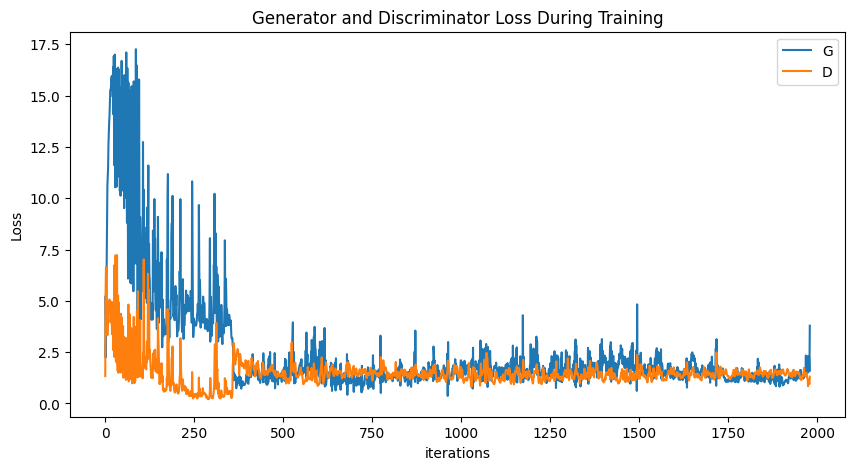

In [23]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21321260 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


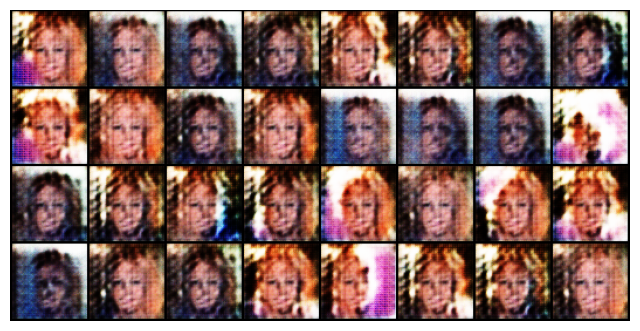

In [24]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())